In [1]:
import os
import numpy as np
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

import pandas as pd
from Bio import SeqIO
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib import cm
from matplotlib.patches import Patch
import mpl_stylesheet
import re
import gc
mpl_stylesheet.banskt_presentation(fontfamily = 'mono', fontsize = 20, colors = 'banskt', dpi = 300)

In [2]:
# Load the data
import json
import collections

datadict = collections.defaultdict(dict)
for record in SeqIO.parse("disprot_OK_fullset.fasta", "fasta"):
    uniprot_id = record.id
    seq = str(record.seq)
    datadict[uniprot_id]['seq'] = seq

for record in SeqIO.parse("disprot_OK_fullset_annotations.fasta", "fasta"):
    uniprot_id = record.id
    seq = str(record.seq)
    datadict[uniprot_id]['disorder'] = seq

   

In [3]:
print(f"Loaded {len(datadict.keys())} proteins")

Loaded 2145 proteins


In [7]:
AA2num = dict(zip(sorted(list(set([i for i in datadict["P19793"]['seq']]))),np.arange(20)))
AA2num['</s>'] = 20
AA2num['X'] = 21
num2AA = dict(zip(np.arange(20),sorted(list(set([i for i in datadict["P19793"]['seq']])))))
num2AA[20] = "</s>"
num2AA[21] = "X"
print(AA2num)
AAsize = len(list(AA2num.keys()))

{'A': 0, 'C': 1, 'D': 2, 'E': 3, 'F': 4, 'G': 5, 'H': 6, 'I': 7, 'K': 8, 'L': 9, 'M': 10, 'N': 11, 'P': 12, 'Q': 13, 'R': 14, 'S': 15, 'T': 16, 'V': 17, 'W': 18, 'Y': 19, '</s>': 20, 'X': 21}


In [4]:
uniprots = list(datadict.keys())
for unip in uniprots:
    lossfile = f"loss_ESM2/{unip}.json"
    if os.path.exists(lossfile):
        #print(unip)
        with open(lossfile) as instrm:
            lossdict = json.load(instrm)
        datadict[unip]["aamask_1"] = lossdict[unip]["aamask_1"]
    else:
        del(datadict[unip])
        

In [5]:
print(f"Loaded {len(datadict.keys())} proteins")

Loaded 313 proteins


In [8]:
## Obtains aa counts for order and disorder regions
order_aa_counts    = np.zeros(AAsize) 
disorder_aa_counts = np.zeros(AAsize)
for unip in datadict:
    seq = datadict[unip]['seq']
    diso_ix = [True if e != "-" else False for e in datadict[unip]['disorder'] ]
    for pos, aa in enumerate(seq):
        if aa not in AA2num:
            aa = "X"
        if diso_ix[pos]:
            disorder_aa_counts[AA2num[aa]] += 1
        else:
            order_aa_counts[AA2num[aa]] += 1


In [11]:
total_aa_counts = order_aa_counts + disorder_aa_counts
total_aa = np.sum(total_aa_counts)
print(total_aa)

118640.0


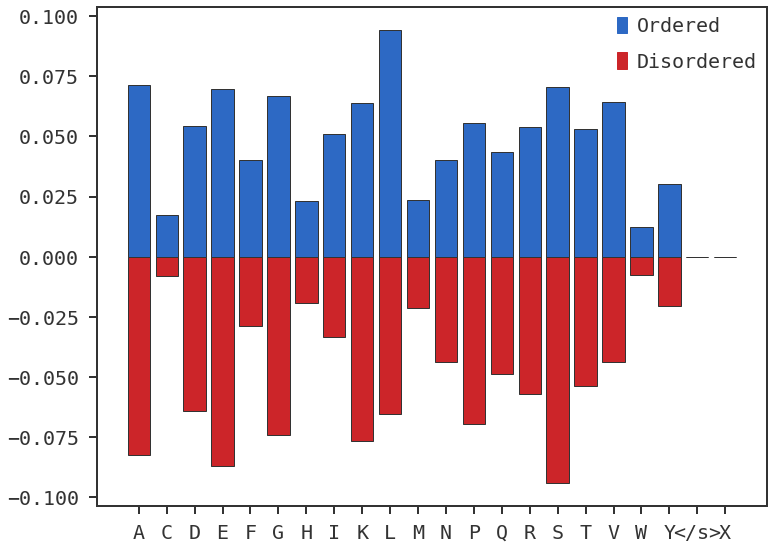

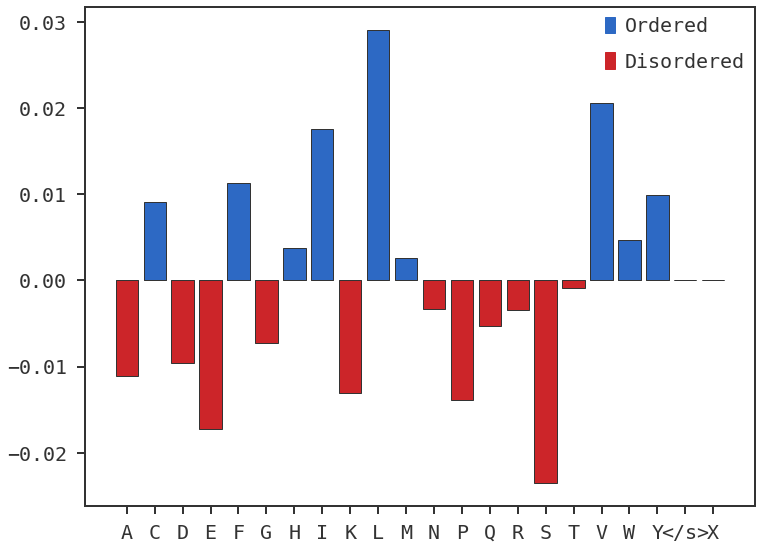

In [10]:
total_ordered_aa = np.sum(order_aa_counts)
total_disordered_aa = np.sum(disorder_aa_counts)
labels = [num2AA[i] for i in range(len(order_aa_counts))]


from matplotlib.lines import Line2D
from matplotlib.patches import Patch

prop_cycle = plt.rcParams['axes.prop_cycle']
colors = prop_cycle.by_key()['color']


fig = plt.figure(figsize=(12,9), dpi=72)
ax1 = fig.add_subplot(111)

ax1.bar(x = np.arange(AAsize), height=order_aa_counts/total_ordered_aa, tick_label=labels)
ax1.bar(x = np.arange(AAsize), height=-disorder_aa_counts/total_disordered_aa, tick_label=labels)

legend_elements = [Patch(facecolor=colors[0], edgecolor=colors[0], label='Ordered'),
                   Patch(facecolor=colors[1], edgecolor=colors[1], label='Disordered')]

ax1.legend(handles=legend_elements, loc='upper right')
plt.show()

fig = plt.figure(figsize=(12,9), dpi=72)
ax1 = fig.add_subplot(111)

diff = (order_aa_counts/total_ordered_aa) - (disorder_aa_counts/total_disordered_aa)
ax1.bar(x = np.arange(AAsize), height=[d  if d >= 0 else 0 for d in diff], tick_label=labels)
ax1.bar(x = np.arange(AAsize), height=[d if d<0 else 0 for d in diff], tick_label=labels)
legend_elements = [Patch(facecolor=colors[0], edgecolor=colors[0], label='Ordered'),
                   Patch(facecolor=colors[1], edgecolor=colors[1], label='Disordered')]

ax1.legend(handles=legend_elements, loc='upper right')
plt.show()



## explorar
* nº de mismatches cuando maskeo en regiones ordenadas/desordenadas
* nº de mismatches con diff > 30, vale la pena explorar? hay un 'rango' donde ya no veo nada o son contactos lejanos?
* matriz de mismatch order/disorder y diff entre ellas
* hay residuos que cuando maskeo obtengo muchos mismatches?? puede ser? qué residuos son y por qué?
* para un aa único aa maskeado, cuál es el max nº de mismatches?


In [12]:
match_counts         = np.zeros(AAsize)     # nº of matches
mismatch_counts_aa   = np.zeros(AAsize)     # nº of total mismatches, could be more than 1 mismatch per masked aa
mismatch_in_disorder = np.zeros(AAsize)
mismatch_in_order    = np.zeros(AAsize)
match_in_disorder = np.zeros(AAsize)
match_in_order    = np.zeros(AAsize)
match_in_order_pos    = list()
match_in_disorder_pos = list()

mismatch_mask_counts = np.zeros(AAsize)     # nº of mismatches per masked aa, one count per masked embedding
mismatch_matrix             = np.zeros((AAsize,AAsize))
mismatch_matrix_in_disorder = np.zeros((AAsize,AAsize))
mismatch_matrix_in_order    = np.zeros((AAsize,AAsize))
mismatch_matrix_in_disorder_onsite = np.zeros((AAsize,AAsize))
mismatch_matrix_in_order_onsite    = np.zeros((AAsize,AAsize))
mismatch_posdiff = list()        # distance of the masked aa to the mismatched position (can separate long and short)
mismatch_posdiff_detail = list() # uniprot, masked aa pos, mismatch pos, prot length
n_pos_mismatch = collections.defaultdict(int) # nº of times a position was mismatched (on different masked aa)
n_mismatch_pos = collections.defaultdict(int) # nº of mismatches encountered for a single masked aa
loss_match    = list()
loss_mismatch = list()
loss_mismatch_in_order = list()
loss_mismatch_in_disorder = list()
onsm_offsmm = list() #on-site match but off-site mismatch
for unip in datadict:
    L = len(datadict[unip]['seq'])
    this_seq = datadict[unip]['seq']
    diso_ix = [True if e != "-" else False for e in datadict[unip]['disorder'] ]
    loss = np.array(datadict[unip]['aamask_1']['loss'])
    matches = datadict[unip]['aamask_1']['match']
    seq_pos = np.arange(len(matches))
    #print(list(zip(seq_pos, matches)))
    for pos,e in enumerate(matches):
        if e == True:
            match_counts[AA2num[this_seq[pos]]] += 1
            loss_match.append([loss[pos], L])
            if diso_ix[pos]: # in disordered region
                match_in_disorder[AA2num[this_seq[pos]]] += 1
                match_in_disorder_pos.append(f"{unip}_{pos}")
            else:
                match_in_order[AA2num[this_seq[pos]]] += 1
                match_in_order_pos.append(f"{unip}_{pos}")
        else:
            mismatch_mask_counts += 1
            loss_mismatch.append([loss[pos], L])
            n_mismatch_pos[f"{unip}_{pos}"] += len(e)
            this_pos_found = False
            for mismatch_aa in e:
                diff = mismatch_aa[0] - pos
                mismatch_posdiff.append(diff)
                mismatch_posdiff_detail.append([unip,pos,mismatch_aa[0],L])
                mismatch_counts_aa[AA2num[mismatch_aa[2]]] += 1
                n_pos_mismatch[f"{unip}_{mismatch_aa[0]}"] += 1
                mismatch_matrix[AA2num[mismatch_aa[2]],AA2num[mismatch_aa[1]]] += 1
                if diso_ix[mismatch_aa[0]]:
                    mismatch_matrix_in_disorder[AA2num[mismatch_aa[2]],AA2num[mismatch_aa[1]]] += 1
                    mismatch_in_disorder[AA2num[mismatch_aa[2]]] += 1
                    if pos == mismatch_aa[0]:
                        mismatch_matrix_in_disorder_onsite[AA2num[mismatch_aa[2]],AA2num[mismatch_aa[1]]] += 1
                        loss_mismatch_in_disorder.append(loss[pos]* L)
                        this_pos_found = True
                else:
                    mismatch_matrix_in_order[AA2num[mismatch_aa[2]],AA2num[mismatch_aa[1]]] += 1
                    mismatch_in_order[AA2num[mismatch_aa[2]]] += 1
                    if pos == mismatch_aa[0]:
                        loss_mismatch_in_order.append(loss[pos]* L)
                        mismatch_matrix_in_order_onsite[AA2num[mismatch_aa[2]],AA2num[mismatch_aa[1]]] += 1
                        this_pos_found = True
            if not this_pos_found:
                ## on-site match but off-site mismatch!!
                match_counts[AA2num[this_seq[pos]]] += 1
                if diso_ix[pos]:
                    match_in_disorder[AA2num[this_seq[pos]]] += 1
                else:
                    match_in_order[AA2num[this_seq[pos]]] += 1
                onsm_offsmm.append([unip,pos])

In [12]:
### Positions with the most mismatches
#{k: v for k, v in sorted(n_pos_mismatch.items(), key=lambda item: item[1], reverse=True)}

In [13]:
### Positions that trigger the most mismatches
#{k: v for k, v in sorted(n_mismatch_pos.items(), key=lambda item: item[1], reverse=True)}

Total: 118640.0
Total disordered: 27141.0
Total ordered: 91499.0
Total mismatches in disorder onsite: 13729.0
Total mismatches in order onsite: 35006.0
Total matches (both): 69905.0


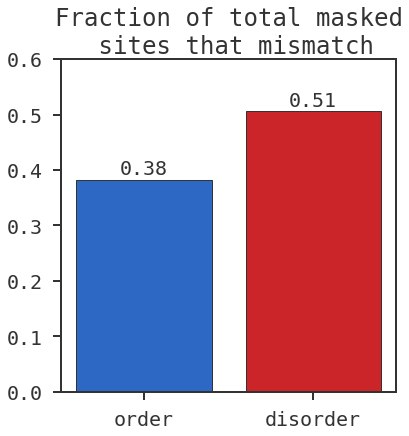

In [14]:
print(f"Total: {total_aa}")
print(f"Total disordered: {total_disordered_aa}")
print(f"Total ordered: {total_ordered_aa}")
print(f"Total mismatches in disorder onsite: {np.sum(mismatch_matrix_in_disorder_onsite)}")
print(f"Total mismatches in order onsite: {np.sum(mismatch_matrix_in_order_onsite)}")
print(f"Total matches (both): {np.sum(match_counts)}")

## onsite mismatches + matches must be equal to total aa
assert total_aa == np.sum(match_counts)+np.sum(mismatch_matrix_in_order_onsite)+np.sum(mismatch_matrix_in_disorder_onsite)

fraction_mm_disorder = np.sum(mismatch_matrix_in_disorder_onsite) / total_disordered_aa
fraction_mm_order    = np.sum(mismatch_matrix_in_order_onsite) / total_ordered_aa

#### This is wrong, but just to check. Above we compare 1 to 1, one masked aa -> one mismatch
#### dividing by "total mismatches" is wrong because one masked aa -> more than one mismatch
#fraction_mm_disorder = np.sum(mismatch_matrix_in_disorder_onsite) / np.sum(mismatch_matrix_in_disorder)
#fraction_mm_order    = np.sum(mismatch_matrix_in_order_onsite) / np.sum(mismatch_matrix_in_order)

fig = plt.figure(figsize=(6,6), dpi=72)
ax1 = fig.add_subplot(111)
b = ax1.bar(x = np.arange(2), height = [fraction_mm_order, 0]) #, tick_label=["order", "disorder"])
b = ax1.bar(x = np.arange(2), height = [0, fraction_mm_disorder], tick_label=["order", "disorder"])

for bar in ax1.patches:
    if bar.get_height() > 0:
        ax1.text(bar.get_x() + bar.get_width() / 2, bar.get_height()+0.02,
                 format(bar.get_height(), '.2f'), 
                 ha='center', va='center')
ax1.set_ylim(0,0.6)
ax1.set_title("Fraction of total masked\n sites that mismatch", ha='center')
plt.show()

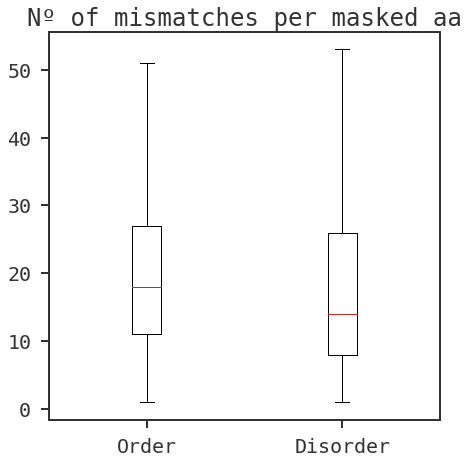

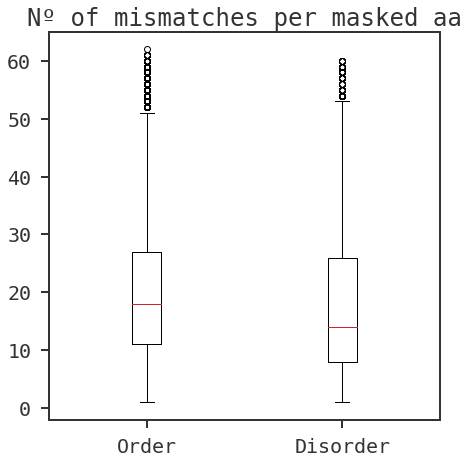

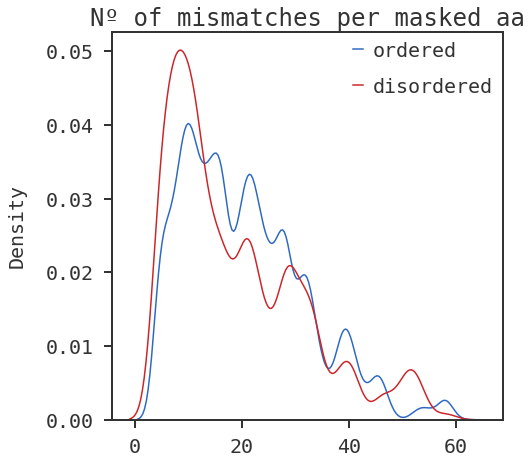

In [15]:
### Count how many mismatches are triggered per masked aa experiment
n_mismatch_maskedaa_in_order    = list()
n_mismatch_maskedaa_in_disorder = list()
for e in n_mismatch_pos:
    unip, pos = e.split("_")
    if datadict[unip]['disorder'][int(pos)] != "-": #is disordered
        n_mismatch_maskedaa_in_disorder.append(n_mismatch_pos[e])
    else:
        n_mismatch_maskedaa_in_order.append(n_mismatch_pos[e])

fig = plt.figure(figsize=(7,7), dpi=72)
ax  = fig.add_subplot(111)
ax.boxplot([n_mismatch_maskedaa_in_order, n_mismatch_maskedaa_in_disorder], labels=["Order", "Disorder"], showfliers=False )
ax.set_title("Nº of mismatches per masked aa")
plt.show()

fig = plt.figure(figsize=(7,7), dpi=72)
ax  = fig.add_subplot(111)
ax.boxplot([n_mismatch_maskedaa_in_order, n_mismatch_maskedaa_in_disorder], labels=["Order", "Disorder"])
ax.set_title("Nº of mismatches per masked aa")
plt.show()


fig = plt.figure(figsize=(7,7), dpi=72)
ax  = fig.add_subplot(111)
#ax.hist([e for e in n_mismatch_maskedaa_in_order if e > 3], density=True, bins=30)
#ax.hist([e for e in n_mismatch_maskedaa_in_disorder if e > 3], density=True, bins=30)
sns.kdeplot([e for e in n_mismatch_maskedaa_in_order if e > 3], label="ordered", ax=ax)
sns.kdeplot([e for e in n_mismatch_maskedaa_in_disorder if e > 3], label="disordered", ax=ax)
ax.set_title("Nº of mismatches per masked aa")
plt.legend()
plt.show()

In [16]:
mismatch_matrix_in_disorder_offsite = mismatch_matrix_in_disorder - mismatch_matrix_in_disorder_onsite
mismatch_matrix_in_order_offsite    = mismatch_matrix_in_order - mismatch_matrix_in_order_onsite
print(f"Proportion of offsite mismatches triggered by mask in disordered region: {np.sum(mismatch_matrix_in_disorder_offsite) / np.sum(mismatch_matrix_in_disorder)}")
print(f"Proportion of offsite mismatches triggered by mask in ordered region: {np.sum(mismatch_matrix_in_order_offsite) / np.sum(mismatch_matrix_in_order)}")

print(f"Proportion of onsite disorder mismatches over total mismatches: {np.sum(mismatch_matrix_in_disorder_onsite) / np.sum(mismatch_matrix_in_disorder)}")
print(f"Proportion of onsite order mismatches over total mismatches: {np.sum(mismatch_matrix_in_order_onsite) / np.sum(mismatch_matrix_in_order)}")


### for offsite mismatches, ordered regions trigger more mismatches! 

Proportion of offsite mismatches triggered by mask in disordered region: 0.9707845131745269
Proportion of offsite mismatches triggered by mask in ordered region: 0.9807563122220451
Proportion of onsite disorder mismatches over total mismatches: 0.029215486825473164
Proportion of onsite order mismatches over total mismatches: 0.01924368777795491


In [17]:
##mismatch_posdiff_detail # uniprot, masked aa pos, mismatch pos, prot length
onsite_mismatches = [e for e in mismatch_posdiff_detail if e[1]==e[2]]
offsite_mismatches = [e for e in mismatch_posdiff_detail if e[1]!=e[2]]
assert len(onsite_mismatches) == np.sum(mismatch_matrix_in_order_onsite)+np.sum(mismatch_matrix_in_disorder_onsite)
print(f"Onsite mismatches:{len(onsite_mismatches)}")
print(f"Offsite mismatches:{len(offsite_mismatches)}")

# relative diff of mismatch: diff / prot_length
order_to_order       = list() 
order_to_disorder    = list()
disorder_to_order    = list()
disorder_to_disorder = list()
for om in offsite_mismatches:
    rel_diff = (om[2] - om[1]) / om[3]
    annot_from = datadict[om[0]]['disorder'][om[1]]
    annot_to   = datadict[om[0]]['disorder'][om[2]]
    if annot_from != "-" and annot_to != "-":
        disorder_to_disorder.append((om,rel_diff))
    if annot_from != "-" and annot_to == "-":
        disorder_to_order.append((om,rel_diff))
    if annot_from == "-" and annot_to != "-":
        order_to_disorder.append((om,rel_diff))
    if annot_from == "-" and annot_to == "-":
        order_to_order.append((om,rel_diff))

print(f"O-O {len(order_to_order)}")
print(f"O-D {len(order_to_disorder)}")
print(f"D-O {len(disorder_to_order)}")
print(f"D-D {len(disorder_to_disorder)}")

Onsite mismatches:48735
Offsite mismatches:2240277
O-O 1529673
O-D 247604
D-O 254411
D-D 208589


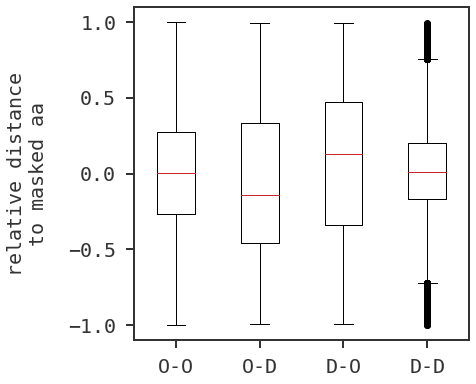

In [18]:
##########################################################
# Relative distances for
# masked aa in an ordered or disordered region
# and the off-site mismatch falling into an ordered or disordered region
##########################################################
o2o = [e[1] for e in order_to_order]
o2d = [e[1] for e in order_to_disorder]
d2o = [e[1] for e in disorder_to_order]
d2d = [e[1] for e in disorder_to_disorder]
fig = plt.figure(figsize=(6,6), dpi=72)
ax  = fig.add_subplot(111)
ax.boxplot([o2o,o2d,d2o,d2d], labels=["O-O", "O-D", "D-O", "D-D"])
ax.set_ylabel("relative distance\nto masked aa")
plt.show()

In [19]:
# Filter mismatches with distance < 3 or distance < 10
# Filter mismatches in position 0 (first position usually fails)
# Filter proteins with less than 3|5|10 mismatches (plus filters above)
# How many proteins per boxplot above? before and after filter criteria?

def filter_mismatches(lista):
    filtered1 = list()
    filtered2 = list()
    rel_dist_filt = list()
    prot_counts = collections.defaultdict(int)
    for e in lista:
        if (e[1] != 0) and (e[2] != 0):
            if np.abs(e[1]-e[2]) > 5:
                filtered1.append(e)
                prot_counts[e[0]] += 1
    for e in filtered1:
        if prot_counts[e[0]] > 3:
            filtered2.append(e)
            rel_dist_filt.append((e[2] - e[1]) / e[3])
    return filtered2, rel_dist_filt

o2o_filt, o2o_reldist_filt = filter_mismatches([e[0] for e in order_to_order])
o2d_filt, o2d_reldist_filt = filter_mismatches([e[0] for e in order_to_disorder])
d2o_filt, d2o_reldist_filt = filter_mismatches([e[0] for e in disorder_to_order])
d2d_filt, d2d_reldist_filt = filter_mismatches([e[0] for e in disorder_to_disorder])

Nº of proteins: 
 O-O: 274
 O-D: 220
 D-O: 273
 D-D: 226


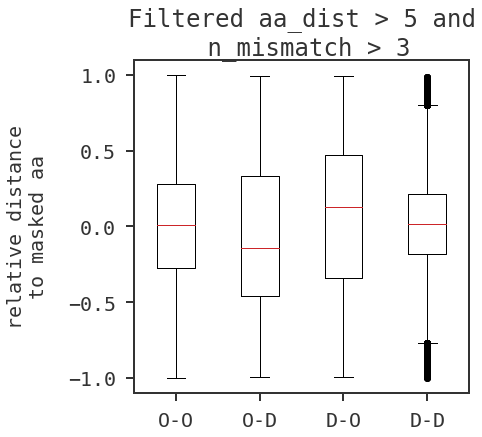

In [20]:
o2o_prots = set([e[0] for e in o2o_filt])
o2d_prots = set([e[0] for e in o2d_filt])
d2o_prots = set([e[0] for e in d2o_filt])
d2d_prots = set([e[0] for e in d2d_filt])

print(f"Nº of proteins: \n O-O: {len(o2o_prots)}\n O-D: {len(o2d_prots)}\n D-O: {len(d2o_prots)}\n D-D: {len(d2d_prots)}")

# for the ones that contain disorder, what is the disprot annotation in those regions?
# filtered dist > 3
# 77 18 20 24
# filtered dist > 8
# 75 17 20 24
fig = plt.figure(figsize=(6,6), dpi=72)
ax  = fig.add_subplot(111)
ax.boxplot([o2o_reldist_filt,o2d_reldist_filt,d2o_reldist_filt,d2d_reldist_filt], labels=["O-O", "O-D", "D-O", "D-D"])
ax.set_ylabel("relative distance\nto masked aa")
ax.set_title("Filtered aa_dist > 5 and\n n_mismatch > 3")
plt.show()

In [21]:
for e in d2d_filt:
    print(f"{e[0]}:{e[1]}{datadict[e[0]]['disorder'][e[1]]} , {e[2]}{datadict[e[0]]['disorder'][e[2]]}")

P03347:377D , 437D
P03347:378D , 437D
P03347:379D , 437D
P03347:380D , 437D
P03347:381D , 437D
P03347:382D , 388D
P03347:382D , 437D
P03347:383D , 437D
P03347:384D , 437D
P03347:385D , 437D
P03347:386D , 437D
P03347:387D , 437D
P03347:388D , 437D
P03347:427D , 437D
P03347:428D , 437D
P03347:429D , 437D
P03347:430D , 437D
P03347:431D , 437D
P03347:443D , 437D
P03347:444D , 437D
P03347:445D , 437D
P03347:446D , 437D
P03347:447D , 437D
P03347:448D , 437D
P19793:1D , 24D
P19793:1D , 104D
P19793:1D , 181D
P19793:2D , 24D
P19793:2D , 104D
P19793:2D , 181D
P19793:3D , 24D
P19793:3D , 104D
P19793:3D , 181D
P19793:4D , 24D
P19793:4D , 104D
P19793:4D , 181D
P19793:5D , 24D
P19793:5D , 104D
P19793:5D , 181D
P19793:6D , 24D
P19793:6D , 104D
P19793:6D , 181D
P19793:7D , 24D
P19793:7D , 104D
P19793:7D , 181D
P19793:8D , 24D
P19793:8D , 104D
P19793:8D , 181D
P19793:9D , 24D
P19793:9D , 104D
P19793:10D , 24D
P19793:10D , 104D
P19793:10D , 181D
P19793:11D , 24D
P19793:11D , 104D
P19793:11D , 181D
P1979

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [22]:
### Investigate in order-2-order if the aminoacids are close in proximity
### The disordered regions will be spaghettis
### but if the order to order mismatches mean they have a contact dependency... maybe we can say so for d-o o-d and d-d

from Bio.PDB.MMCIF2Dict import MMCIF2Dict

def get_AF_xyz(unip):
    # read in the CIF file.
    file = f"./AF/AF-{unip}-F1-model_v4.cif"
    pdb_info = MMCIF2Dict(file)

    seq = pdb_info["_entity_poly.pdbx_seq_one_letter_code"][0].replace("\n", "")

    pLDDT_seq = pdb_info['_ma_qa_metric_local.label_seq_id']
    pLDDT = pdb_info['_ma_qa_metric_local.metric_value']

    pdb_coords = list()
    for i in list(zip(pdb_info['_atom_site.label_seq_id'], pdb_info['_atom_site.label_comp_id'], pdb_info['_atom_site.label_atom_id'], pdb_info['_atom_site.Cartn_x'],pdb_info['_atom_site.Cartn_y'],pdb_info['_atom_site.Cartn_z'])):
        if i[2] == "CA":
            pdb_coords.append(list(i))
    return pdb_coords

In [23]:
## Download PAE for those uniprots (Predicted Aligned Error)
## Score should be good for ordered? otherwise maybe it's two domains that are not in the correct orientation
#f"AF-{unip}-F1-predicted_aligned_error_v4.json"
import requests

def download_PAEs(uniprot_list):
    pae_success_unipids = list()
    failed_unipids = list()
    for unip in uniprot_list:
        file = f"./AF/AF-{unip}-F1-predicted_aligned_error_v4.json"
        if not os.path.exists(file):
            fileurl = f"https://alphafold.ebi.ac.uk/files/AF-{unip}-F1-predicted_aligned_error_v4.json"
            #print(fileurl)
            #print(f"wget -O {file} {fileurl}")
            # # try:
            res = requests.get(fileurl)
            if res.status_code == 200:
                print(unip)
                with open(file, 'w') as outfmt:
                    outfmt.write(res.content.decode())
                    pae_success_unipids.append(unip)
            else:
                print(f"Failed to get AF2 PAE model for {unip}")
                print(res)
                failed_unipids.append(unip)
        else:
            print(f"File exists: {unip}")
            pae_success_unipids.append(unip)
    return pae_success_unipids

pae_success_unipids = download_PAEs(o2o_prots)

Q9Y6I3
G5EFZ1
P20340
P26368
O25010
P25638
P11746
Q13351
Failed to get AF2 PAE model for P04324
<Response [404]>
P9WI73
O43663
Q5T1C6
A0A060ZAA1
P35201
P0AD27
Failed to get AF2 PAE model for Q9WBP8
<Response [404]>
Q14457
P53816
P0ABJ3
P07749
Q14449
Failed to get AF2 PAE model for Q9Q8E9
<Response [404]>
Q8VEL9
P01106
Failed to get AF2 PAE model for O89467
<Response [404]>
File exists: Q12142
P40855
Q15726
Q9NQA5
B2LME8
Q6QCC2
P52945
File exists: P14907
P58753
Q9NVS9
F1QR43
O95391
Q9HAN9
P61765
P08263
Q13043
P02655
Failed to get AF2 PAE model for P27392
<Response [404]>
P0A8S9
P23321
P01009
P63027
P70280
O00214
Failed to get AF2 PAE model for P69718
<Response [404]>
P24255
Q24246
Q0PF16
Failed to get AF2 PAE model for Q5UPT2
<Response [404]>
B9UCQ5
P32684
E3T1W8
E6Y5X0
Q8NHZ8
P12996
File exists: F1QGH7
P16243
Q96PU8
Q9RFD6
Q980M2
Failed to get AF2 PAE model for Q16222-2
<Response [404]>
Q14691
Q9I9C0
Q9S7B5
Q60795
File exists: P04637
P09041
Failed to get AF2 PAE model for Q9JLC3
<Respon

KeyboardInterrupt: 

In [24]:
unip = list(o2o_prots)[0]

def get_AF_PAE(unip):
    paefile = f"./AF/AF-{unip}-F1-predicted_aligned_error_v4.json"
    with open(paefile) as instream:
        paedata = json.load(instream)
        pae_matrix = np.array(paedata[0]['predicted_aligned_error'])
    
    return pae_matrix
#list(pdb_info.keys())

In [25]:
from Bio.PDB.MMCIF2Dict import MMCIF2Dict

def get_AF_xyz(unip):
    pdb_coords = list()
    file = f"./AF/AF-{unip}-F1-model_v4.cif"
    pdb_info = MMCIF2Dict(file)
    for i in list(zip(pdb_info['_atom_site.label_seq_id'], pdb_info['_atom_site.label_comp_id'], pdb_info['_atom_site.label_atom_id'], pdb_info['_atom_site.Cartn_x'],pdb_info['_atom_site.Cartn_y'],pdb_info['_atom_site.Cartn_z'])):
        if i[2] == "CA":
            pdb_coords.append(list(i))
    return pdb_coords

def get_AF_pLDDT(unip):
    pdb_coords = list()
    file = f"./AF/AF-{unip}-F1-model_v4.cif"
    pdb_info = MMCIF2Dict(file)
    pLDDT = pdb_info['_ma_qa_metric_local.metric_value']
    return pLDDT

In [26]:
o2o_unip_data[:10]

NameError: name 'o2o_unip_data' is not defined

In [ ]:
## X-axis is onsite
## Y-axis is offsite
## checked during match_analysis (transposed PAE matrix, imshow and scatter use different coords)
o2o_dist_dict = collections.defaultdict(list)
o2o_plddt_dict = collections.defaultdict(list)
for i, unip in enumerate(pae_success_unipids):
    print(unip)
    pdb_coords = get_AF_xyz(unip)
    pae_matrix = get_AF_PAE(unip)
    pLDDT = get_AF_pLDDT(unip)
    o2o_unip_data = [e for e in o2o_filt if e[0] == unip]
    seq = datadict[unip]['seq']
    if len(pdb_coords) != len(seq):
        print(f"PDB:{len(pdb_coords)}, seq:{len(seq)}")
        continue
    plt.imshow(pae_matrix.T, origin="lower")
    for e in o2o_unip_data:
        pos = e[1]
        offsite = e[2]
        #print(seq[pos], seq[offsite])
        x1 = float(pdb_coords[pos-1][3])
        y1 = float(pdb_coords[pos-1][4])
        z1 = float(pdb_coords[pos-1][5])
        x2 = float(pdb_coords[offsite-1][3])
        y2 = float(pdb_coords[offsite-1][4])
        z2 = float(pdb_coords[offsite-1][5])
        dist = np.sqrt( np.square(x2-x1) + np.square(y2-y1) + np.square(z2-z1) )
        o2o_dist_dict[unip].append(dist)
        o2o_plddt_dict[unip].append(f"{unip}_{pos}_{pLDDT[pos]}")
        o2o_plddt_dict[unip].append(f"{unip}_{pos}_{pLDDT[offsite]}")
        #print(pdb_coords[pos], pdb_coords[offsite])
        #print(pae_matrix[pos, offsite], pae_matrix[offsite,pos])
        plt.scatter(pos,offsite,color='r', s=2)
    # raise
    plt.savefig(f"plots/{unip}_o2o_offsite_mm_pae.png", bbox_inches="tight")
    plt.show()

In [86]:
print("o2d")
pae_success_unipids_o2d = download_PAEs(o2d_prots)
print("d2o")
pae_success_unipids_d2o = download_PAEs(d2o_prots)
print("d2d")
pae_success_unipids_d2d = download_PAEs(d2d_prots)

set.intersection(set(pae_success_unipids_o2d), set(pae_success_unipids_d2o), set(pae_success_unipids_d2d))

o2d
File exists: Q96PU5
File exists: P42226
File exists: O94258
File exists: Q0WYX8
File exists: Q9VKJ9
File exists: Q51912
File exists: Q61548
File exists: Q7Z3C6
File exists: P35611
File exists: Q03479
File exists: O60934
File exists: P35869
File exists: P52630
File exists: Q9Y5B0
File exists: P10388
File exists: O13828
File exists: P06400
File exists: P21575
File exists: Q6P1M3
File exists: Q27974
File exists: Q05193
File exists: P19634
d2o
File exists: Q96PU5
File exists: Q05140
File exists: Q9UQC2
File exists: Q9Z1X4
File exists: Q00653
File exists: Q61548
File exists: O15169
File exists: P51400
File exists: Q9UNA0
File exists: Q9YGY0
File exists: P35869
File exists: P21580
File exists: P15498
File exists: P10388
File exists: Q2GI62
File exists: P97303
File exists: Q9QUG2
File exists: Q16665
File exists: P09327
File exists: P21575
File exists: Q6P1M3
File exists: P10275
File exists: Q05193
d2d
File exists: Q14978
File exists: P32499
File exists: P18564
File exists: Q0WYX8
File exi

{'P10388', 'P21575', 'P35869', 'Q6P1M3'}

In [ ]:
for u in o2o_dist_dict:
    plddts = np.array([float(e.split("_")[2]) for e in list(set(o2o_plddt_dict[u]))])
    #mean_plddt = np.mean(plddts)
    print(u, np.mean(np.array(o2o_dist_dict[u])), mean_plddt, len(plddts))
    plt.hist(plddts)
    plt.show()
    

File exists: P10388
File exists: P21575
File exists: P35869
File exists: Q6P1M3
P10388


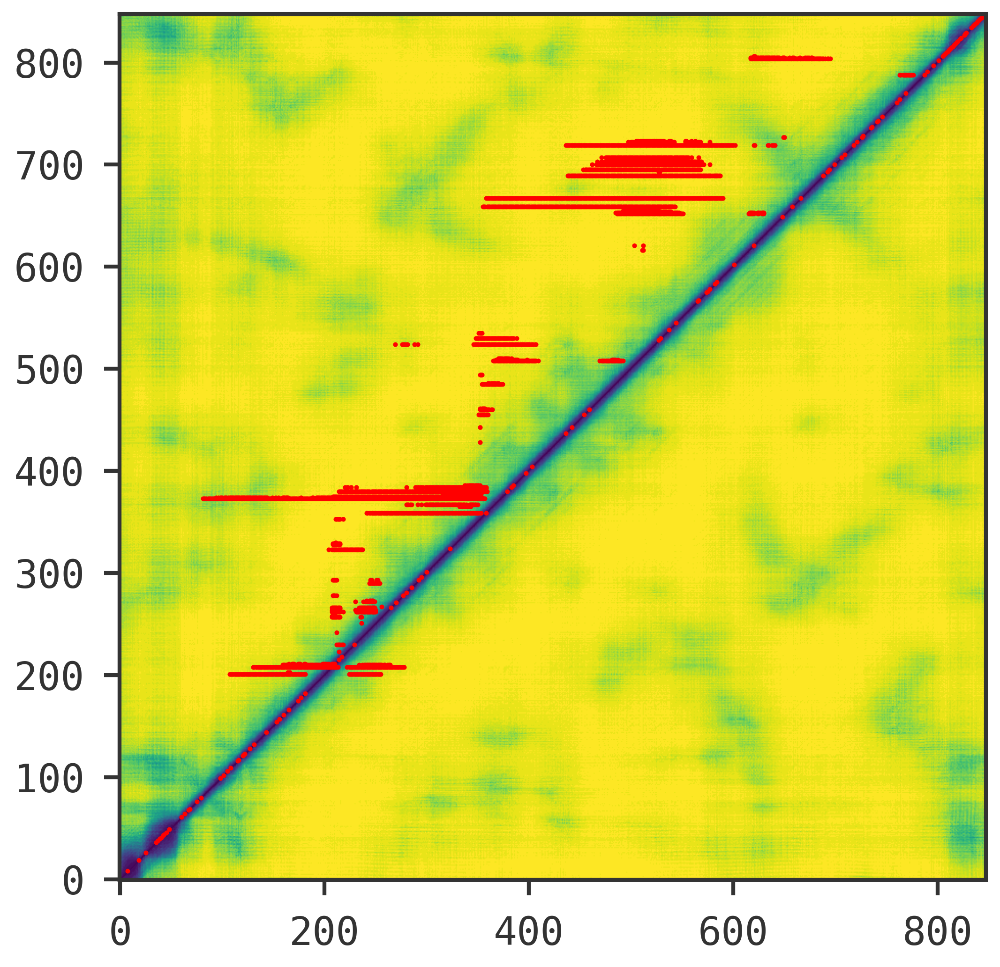

P21575


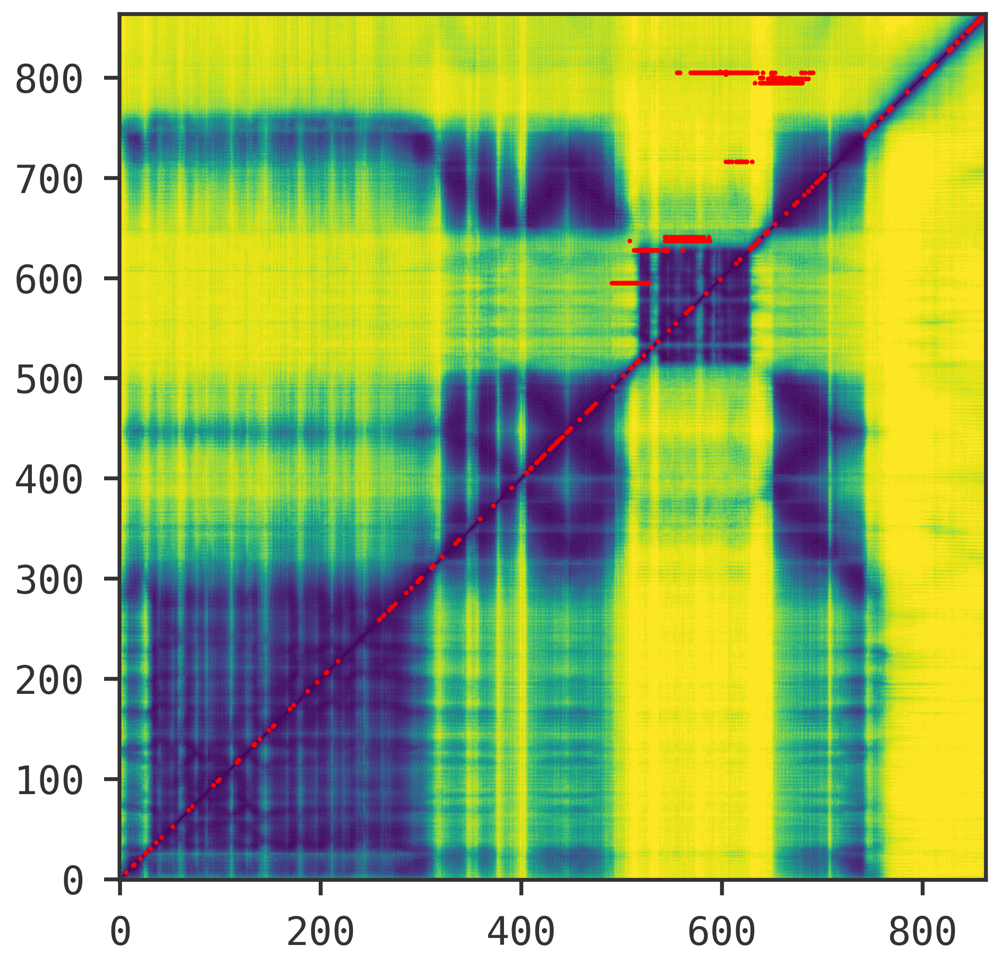

P35869


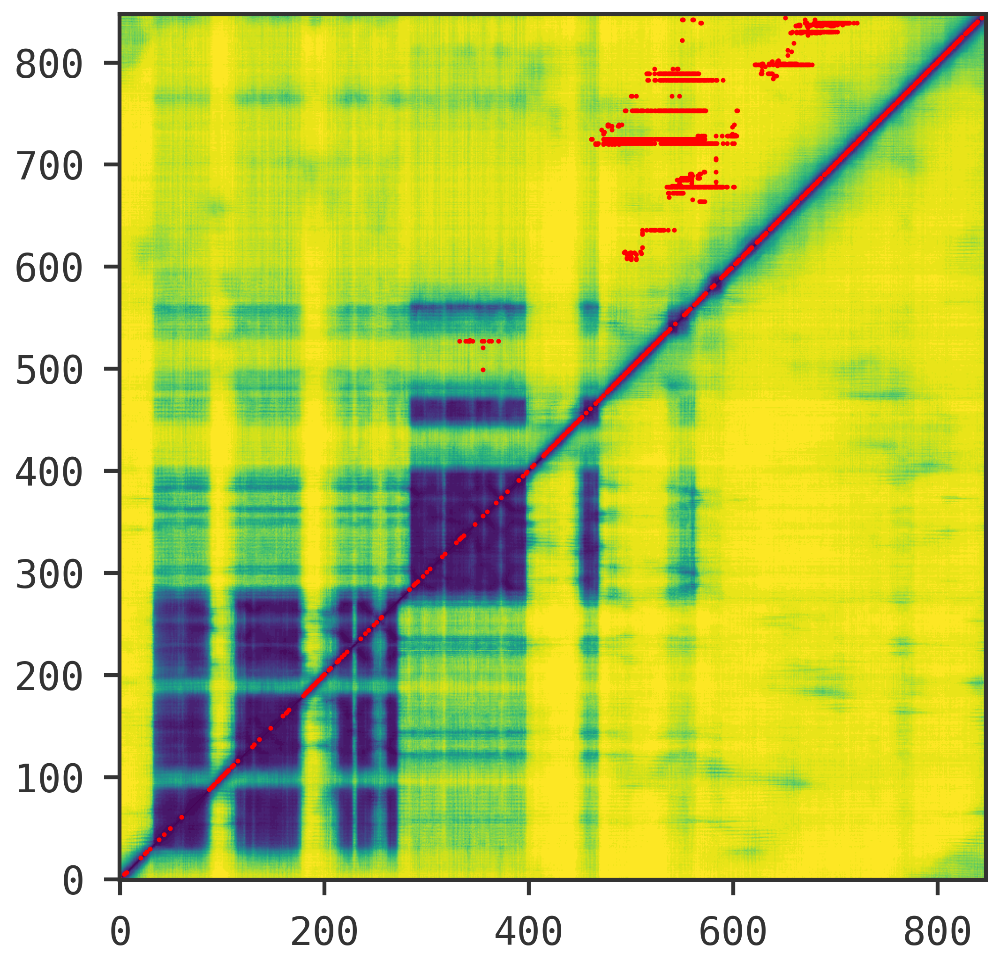

Q6P1M3


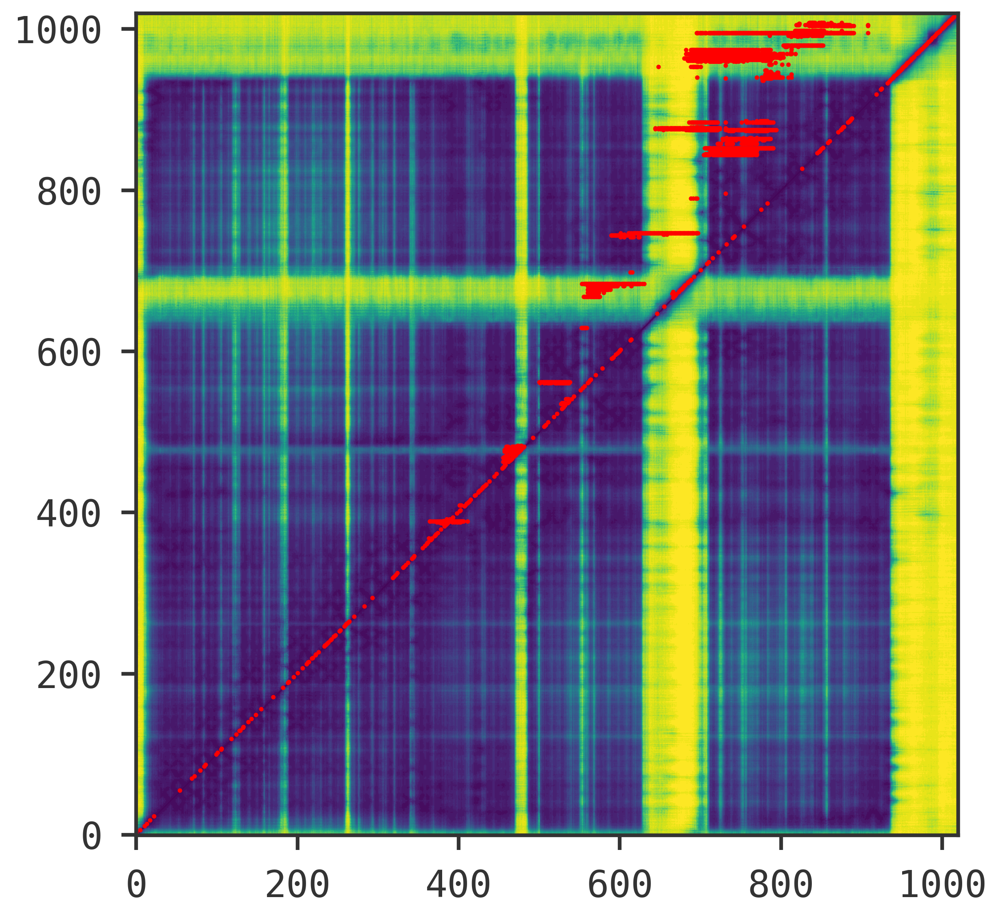

In [90]:
#target_unips = ["P04637", "P06401", "P23441"]  #from the set of 10 riginal selected proteins

#target_unips = ["Q9Z1X4", "Q16665"] # some examples taken from the o2o, o2d, d2o, and d2d filters

target_unips = ['P10388', 'P21575', 'P35869', 'Q6P1M3'] # unips with intersection of 3 aboves

ok_unips = download_PAEs(target_unips)

for unip in ok_unips:
    print(unip)
    subset_offsite_mismatches = [i for i in offsite_mismatches if i[0] == unip]
    if len(subset_offsite_mismatches) == 0:
        print(f"No mismatches for {unip}")
        raise
    pdb_coords = get_AF_xyz(unip)
    pae_matrix = get_AF_PAE(unip)
    pLDDT = get_AF_pLDDT(unip)
    seq = datadict[unip]['seq']
    if len(pdb_coords) != len(seq):
        print(f"PDB:{len(pdb_coords)}, seq:{len(seq)}")
        continue
    plt.imshow(pae_matrix.T, origin="lower")
    for e in subset_offsite_mismatches:
        pos = e[1]
        offsite = e[2]
        #print(seq[pos], seq[offsite])
        x1 = float(pdb_coords[pos-1][3])
        y1 = float(pdb_coords[pos-1][4])
        z1 = float(pdb_coords[pos-1][5])
        x2 = float(pdb_coords[offsite-1][3])
        y2 = float(pdb_coords[offsite-1][4])
        z2 = float(pdb_coords[offsite-1][5])
        dist = np.sqrt( np.square(x2-x1) + np.square(y2-y1) + np.square(z2-z1) )
        o2o_dist_dict[unip].append(dist)
        o2o_plddt_dict[unip].append(f"{unip}_{pos}_{pLDDT[pos]}")
        o2o_plddt_dict[unip].append(f"{unip}_{pos}_{pLDDT[offsite]}")
        #print(pdb_coords[pos], pdb_coords[offsite])
        #print(pae_matrix[pos, offsite], pae_matrix[offsite,pos])
        plt.scatter(pos,offsite,color='r', s=2)
    # raise
    plt.savefig(f"plots/{unip}_o2o_offsite_mm_pae.png", bbox_inches="tight")
    plt.show()

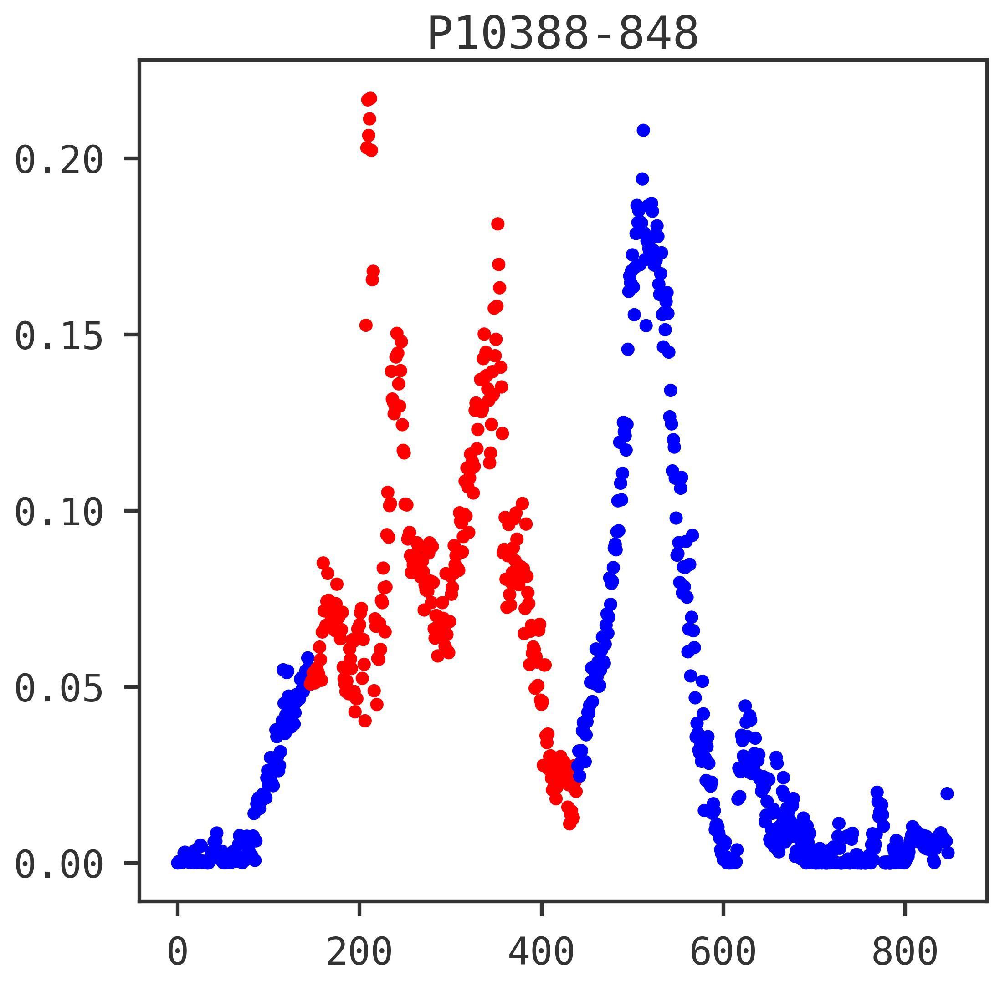

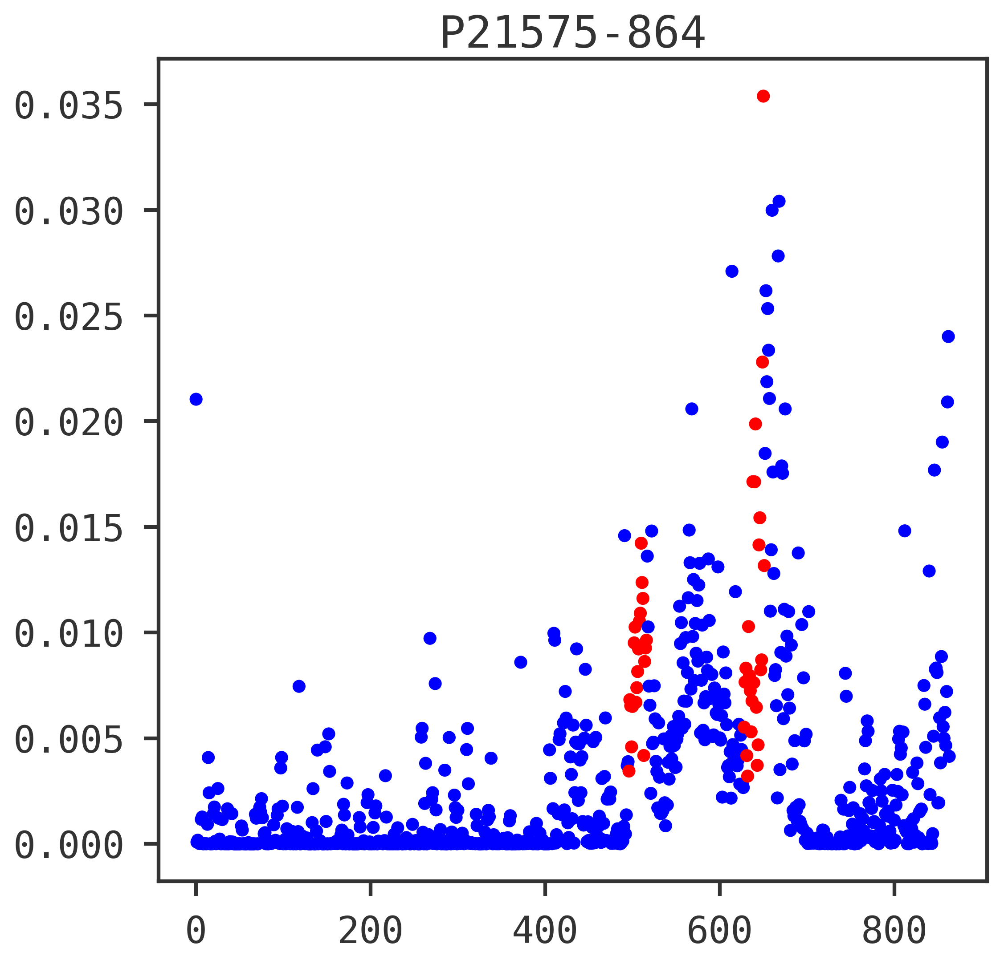

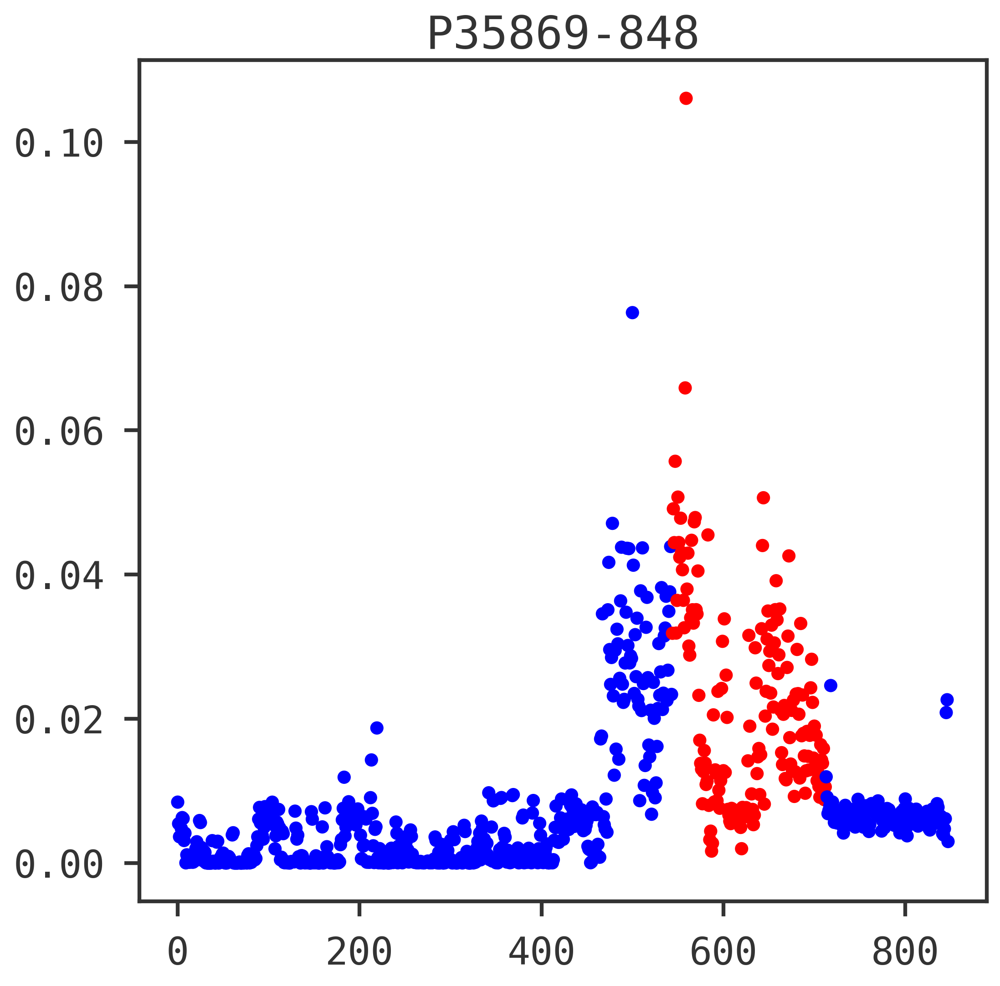

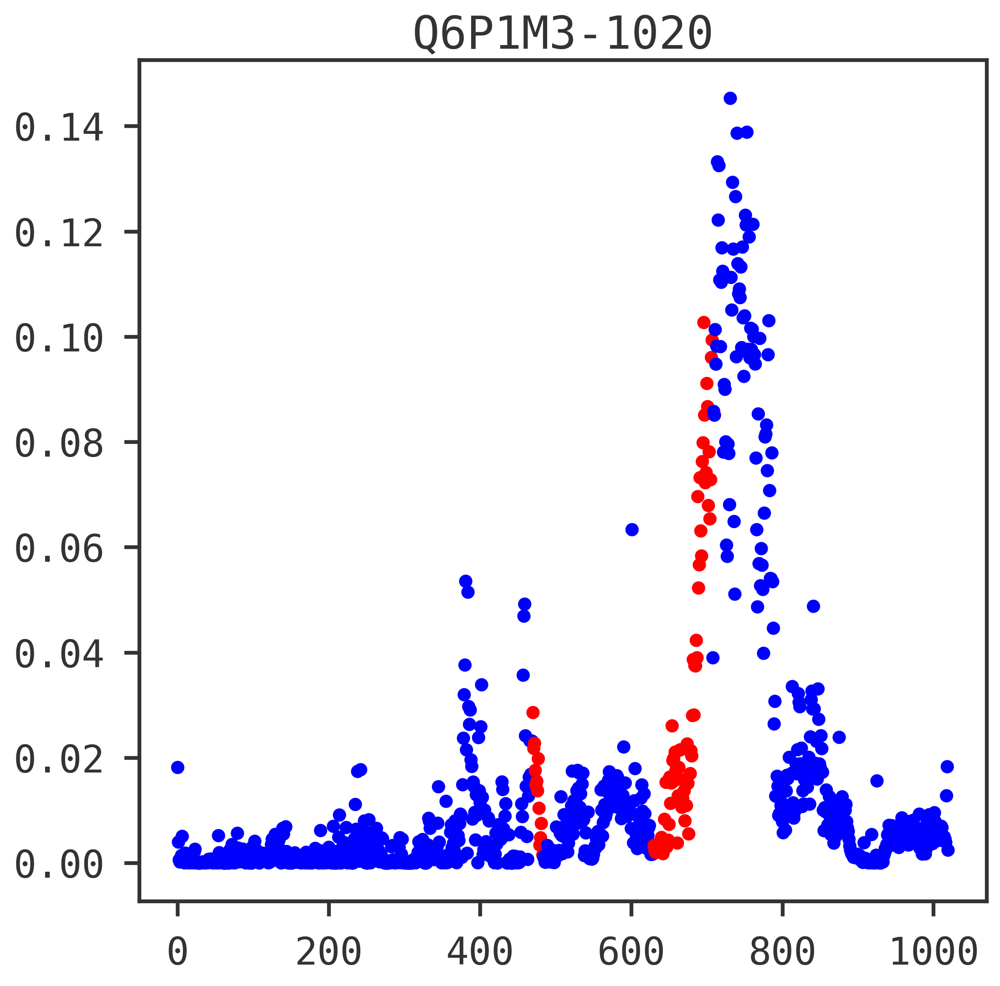

In [91]:

for unip in target_unips:
    seq = datadict[unip]['seq']
    disorder = datadict[unip]['disorder']
    loss = np.array(datadict[unip]['aamask_1']['loss'])
    colorlist = list()
    for i in range(len(loss)):
        if disorder[i] == "-":
            colorlist.append("b")
        else:
            colorlist.append("r")

    fig = plt.figure()
    ax  = fig.add_subplot(111)
    ax.scatter(np.arange(len(loss)), loss, color=colorlist)
    ax.set_title(f"{unip}-{len(seq)}")
    plt.show()

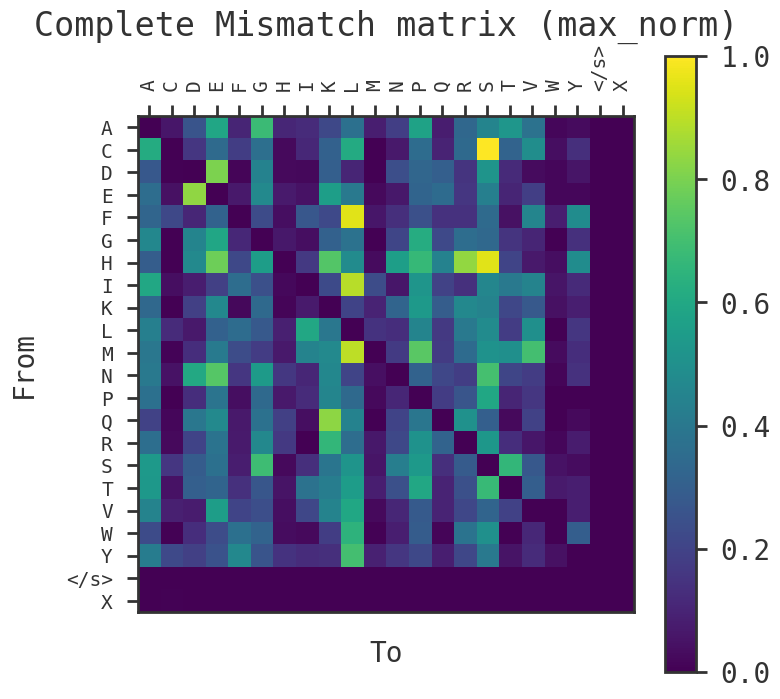

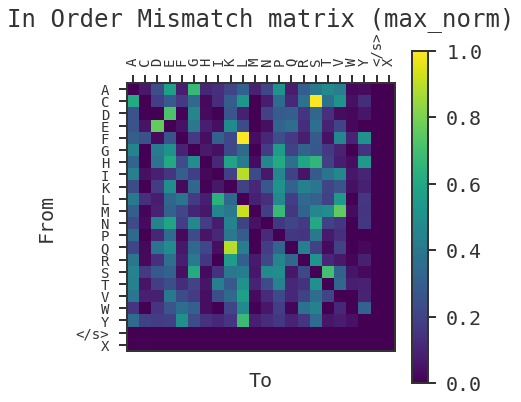

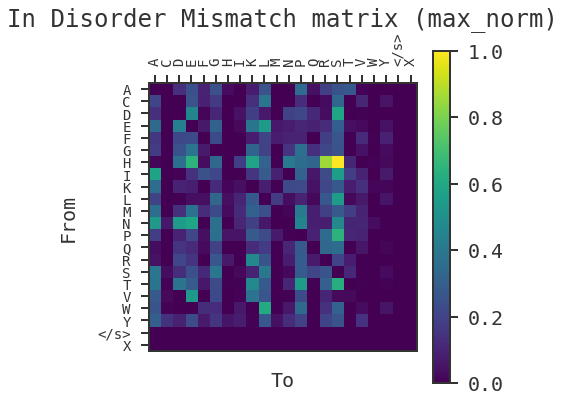

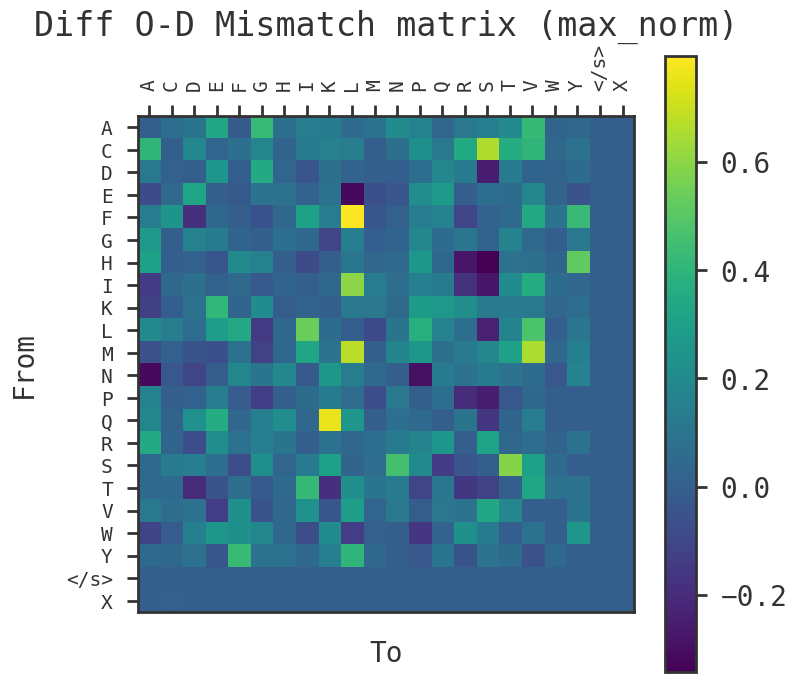

In [27]:
## Matrices are scaled by their maximum number of mismatches (0 to 1 across the entire matrix)

fig = plt.figure(dpi=100)
ax  = fig.add_subplot(111)

mm_matrix = mismatch_matrix / np.max(mismatch_matrix)
i0 = ax.imshow(mm_matrix, origin='upper')
ax.xaxis.tick_top()
ax.set_ylabel("From")
ax.set_xlabel("To")
ax.set_xticks(np.arange(len(AA2num.keys())))
ax.set_yticks(np.arange(len(AA2num.keys())))
ax.set_xticklabels(list(AA2num), fontsize=14, rotation=90)
ax.set_yticklabels(list(AA2num), fontsize=14)
ax.set_title("Complete Mismatch matrix (max_norm)")
plt.colorbar(mappable=i0, ax=ax)
plt.show()

mmorder = mismatch_matrix_in_order/np.max(mismatch_matrix_in_order)
mmdisorder = mismatch_matrix_in_disorder/np.max(mismatch_matrix_in_disorder)

fig = plt.figure(figsize=(6,6), dpi=72)
ax1  = fig.add_subplot(111)
i1 = ax1.imshow(mmorder, origin='upper')
ax1.xaxis.tick_top()
ax1.set_ylabel("From")
ax1.set_xlabel("To")
ax1.set_xticks(np.arange(len(AA2num.keys())))
ax1.set_yticks(np.arange(len(AA2num.keys())))
ax1.set_xticklabels(list(AA2num), fontsize=14, rotation=90)
ax1.set_yticklabels(list(AA2num), fontsize=14)
ax1.set_title("In Order Mismatch matrix (max_norm)")
plt.colorbar(mappable=i1, ax=ax1)
plt.show()

fig = plt.figure(figsize=(6,6), dpi=72)
ax2  = fig.add_subplot(111)
i2 = ax2.imshow(mmdisorder, origin='upper')
ax2.xaxis.tick_top()
ax2.set_ylabel("From")
ax2.set_xlabel("To")
ax2.set_xticks(np.arange(len(AA2num.keys())))
ax2.set_yticks(np.arange(len(AA2num.keys())))
ax2.set_xticklabels(list(AA2num), fontsize=14, rotation=90)
ax2.set_yticklabels(list(AA2num), fontsize=14)

ax2.set_title("In Disorder Mismatch matrix (max_norm)")
plt.colorbar(mappable=i2, ax=ax2)
plt.show()

fig = plt.figure(dpi=100)
ax  = fig.add_subplot(111)
i = ax.imshow(mmorder-mmdisorder, origin='upper')
ax.xaxis.tick_top()

ax.set_ylabel("From")
ax.set_xlabel("To")
ax.set_xticks(np.arange(len(AA2num.keys())))
ax.set_yticks(np.arange(len(AA2num.keys())))
ax.set_xticklabels(list(AA2num), fontsize=14, rotation=90)
ax.set_yticklabels(list(AA2num), fontsize=14)
ax.set_title("Diff O-D Mismatch matrix (max_norm)")
plt.colorbar(mappable=i, ax=ax)
plt.show()

/tmp/ipykernel_27816/2201335411.py:6: RuntimeWarning: invalid value encountered in divide
  mm_matrix = mismatch_matrix / total_aa_counts[:,None]


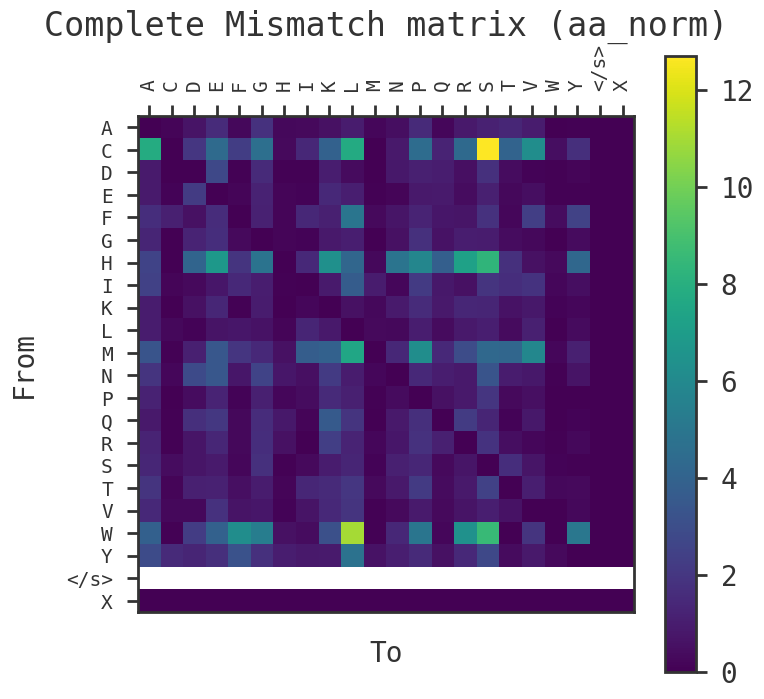

/tmp/ipykernel_27816/2201335411.py:21: RuntimeWarning: invalid value encountered in divide
  mmorder = mismatch_matrix_in_order / order_aa_counts[:,None]
/tmp/ipykernel_27816/2201335411.py:22: RuntimeWarning: invalid value encountered in divide
  mmdisorder = mismatch_matrix_in_disorder / disorder_aa_counts[:,None]


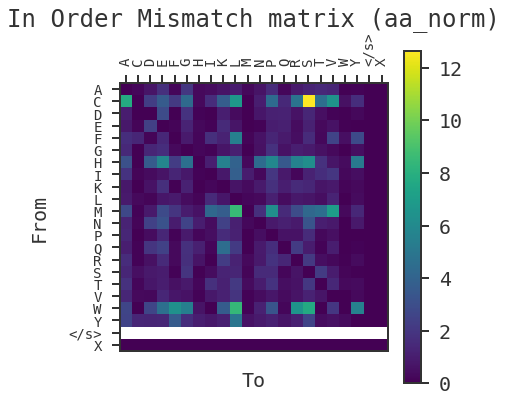

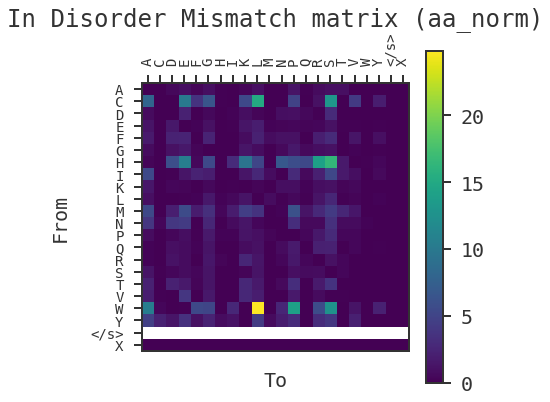

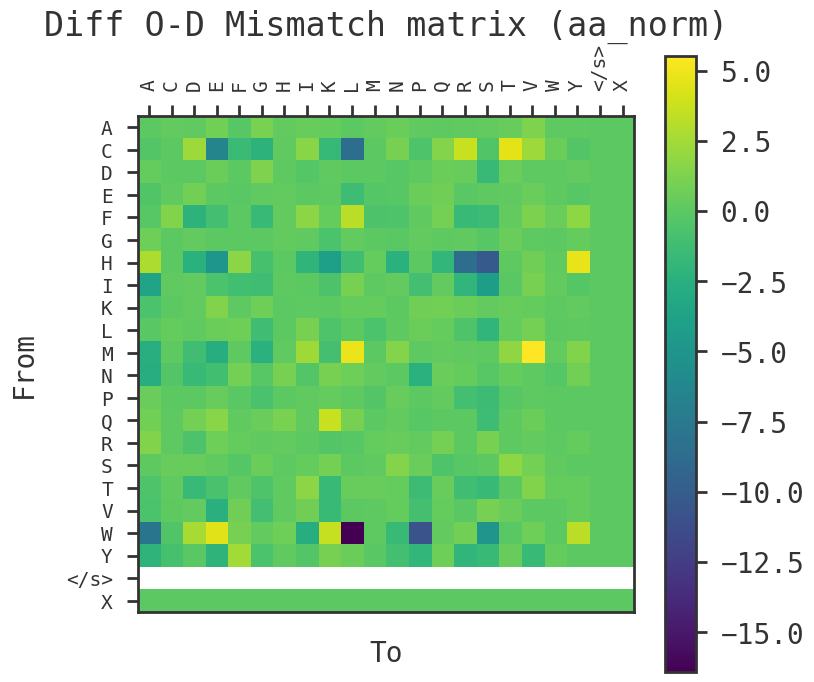

In [28]:
## Matrices are scaled per row, by the number of total AAs of that type (in order or disordered regions, or both)

fig = plt.figure(dpi=100)
ax  = fig.add_subplot(111)

mm_matrix = mismatch_matrix / total_aa_counts[:,None]
mm_matrix[-1,:] = np.zeros(mm_matrix.shape[1])

i0 = ax.imshow(mm_matrix, origin='upper')
ax.xaxis.tick_top()
ax.set_ylabel("From")
ax.set_xlabel("To")
ax.set_xticks(np.arange(len(AA2num.keys())))
ax.set_yticks(np.arange(len(AA2num.keys())))
ax.set_xticklabels(list(AA2num), fontsize=14, rotation=90)
ax.set_yticklabels(list(AA2num), fontsize=14)
ax.set_title("Complete Mismatch matrix (aa_norm)")
plt.colorbar(mappable=i0, ax=ax)
plt.show()

mmorder = mismatch_matrix_in_order / order_aa_counts[:,None]
mmdisorder = mismatch_matrix_in_disorder / disorder_aa_counts[:,None]

mmorder[-1,:] = np.zeros(mmorder.shape[1])
mmdisorder[-1,:] = np.zeros(mmdisorder.shape[1])

fig = plt.figure(figsize=(6,6), dpi=72)
ax1  = fig.add_subplot(111)
i1 = ax1.imshow(mmorder, origin='upper')
ax1.xaxis.tick_top()
ax1.set_ylabel("From")
ax1.set_xlabel("To")
ax1.set_xticks(np.arange(len(AA2num.keys())))
ax1.set_yticks(np.arange(len(AA2num.keys())))
ax1.set_xticklabels(list(AA2num), fontsize=14, rotation=90)
ax1.set_yticklabels(list(AA2num), fontsize=14)
ax1.set_title("In Order Mismatch matrix (aa_norm)")
plt.colorbar(mappable=i1, ax=ax1)
plt.show()

fig = plt.figure(figsize=(6,6), dpi=72)
ax2  = fig.add_subplot(111)
i2 = ax2.imshow(mmdisorder, origin='upper')
ax2.xaxis.tick_top()
ax2.set_ylabel("From")
ax2.set_xlabel("To")
ax2.set_xticks(np.arange(len(AA2num.keys())))
ax2.set_yticks(np.arange(len(AA2num.keys())))
ax2.set_xticklabels(list(AA2num), fontsize=14, rotation=90)
ax2.set_yticklabels(list(AA2num), fontsize=14)

ax2.set_title("In Disorder Mismatch matrix (aa_norm)")
plt.colorbar(mappable=i2, ax=ax2)
plt.show()

fig = plt.figure(dpi=100)
ax  = fig.add_subplot(111)
i = ax.imshow(mmorder-mmdisorder, origin='upper')
ax.xaxis.tick_top()

ax.set_ylabel("From")
ax.set_xlabel("To")
ax.set_xticks(np.arange(len(AA2num.keys())))
ax.set_yticks(np.arange(len(AA2num.keys())))
ax.set_xticklabels(list(AA2num), fontsize=14, rotation=90)
ax.set_yticklabels(list(AA2num), fontsize=14)
ax.set_title("Diff O-D Mismatch matrix (aa_norm)")
plt.colorbar(mappable=i, ax=ax)
plt.show()

In [29]:
order_aa_counts

array([6.526e+03, 1.583e+03, 4.986e+03, 6.371e+03, 3.668e+03, 6.127e+03,
       2.110e+03, 4.659e+03, 5.833e+03, 8.645e+03, 2.168e+03, 3.693e+03,
       5.090e+03, 3.976e+03, 4.918e+03, 6.464e+03, 4.854e+03, 5.905e+03,
       1.139e+03, 2.783e+03, 0.000e+00, 1.000e+00])

In [30]:
mm_matrix = mismatch_matrix / total_aa_counts[:,None]
mm_matrix[-1,:] = np.zeros(mm_matrix.shape[1])
mm_matrix[-1,:]

/tmp/ipykernel_27816/726646619.py:1: RuntimeWarning: invalid value encountered in divide
  mm_matrix = mismatch_matrix / total_aa_counts[:,None]


array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0.])

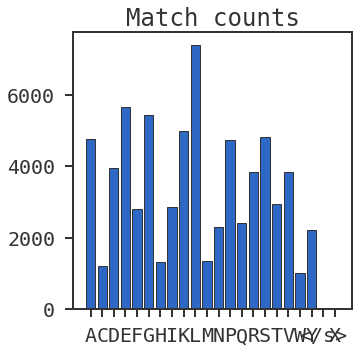

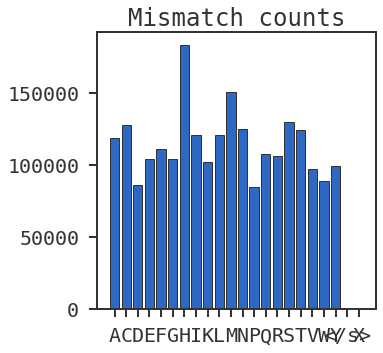

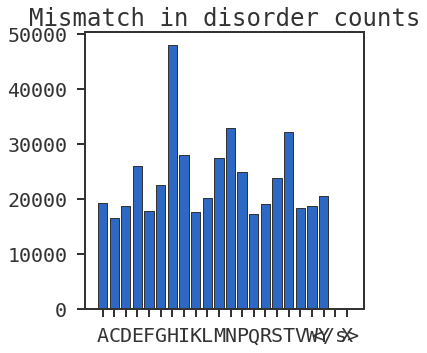

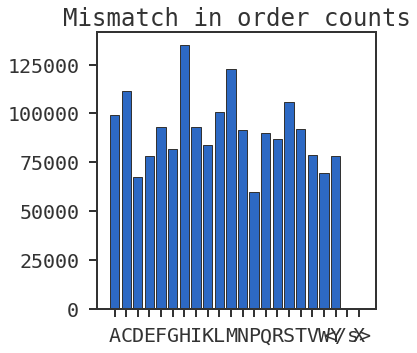

array([4775., 1215., 3947., 5679., 2795., 5457., 1306., 2861., 4999.,
       7415., 1352., 2300., 4735., 2419., 3829., 4822., 2940., 3846.,
       1006., 2207.,    0.,    0.])

In [31]:
# match_counts              # nº of matches
# mismatch_counts_aa        # nº of total mismatches, could be more than 1 mismatch per masked aa
# mismatch_in_disorder 
# mismatch_in_order    

labels = [num2AA[i] for i in range(len(match_counts))]

fig = plt.figure(figsize=(5,5), dpi=72)
ax  = fig.add_subplot(111)
ax.bar(x=np.arange(len(match_counts)), height=match_counts, tick_label=labels)
ax.set_title("Match counts")
plt.show()

fig = plt.figure(figsize=(5,5), dpi=72)
ax  = fig.add_subplot(111)
ax.bar(x=np.arange(len(match_counts)), height=mismatch_counts_aa, tick_label=labels)
ax.set_title("Mismatch counts")
plt.show()

fig = plt.figure(figsize=(5,5), dpi=72)
ax  = fig.add_subplot(111)
ax.bar(x=np.arange(len(match_counts)), height=mismatch_in_disorder, tick_label=labels)
ax.set_title("Mismatch in disorder counts")
plt.show()

fig = plt.figure(figsize=(5,5), dpi=72)
ax  = fig.add_subplot(111)
ax.bar(x=np.arange(len(match_counts)), height=mismatch_in_order, tick_label=labels)
ax.set_title("Mismatch in order counts")
plt.show()

match_counts

In [32]:
############# Loss Analysis ######################
loss_match_dict = collections.defaultdict(list)
loss_mismatch_dict = collections.defaultdict(list)
for e in loss_match:
    loss_match_dict[e[1]].append(e[0])

for e in loss_mismatch:
    loss_mismatch_dict[e[1]].append(e[0])

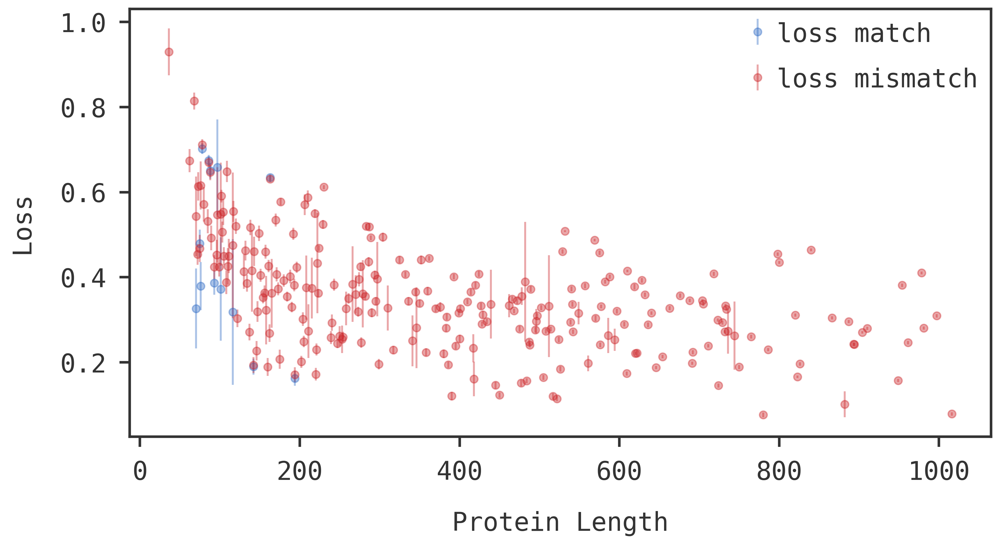

In [33]:
avg_loss_matches = list()
std_loss_matches  = list()
lengths_match = sorted(list(loss_match_dict.keys()))
for L in lengths_match:
    avg_loss_matches.append(np.mean(loss_match_dict[L]))
    std_loss_matches.append(np.std(loss_mismatch_dict[L]))

avg_loss_mismatches = list()
std_loss_mismatches  = list()
lengths_mismatch = sorted(list(loss_mismatch_dict.keys()))
for L in lengths_mismatch:
    avg_loss_mismatches.append(np.mean(loss_mismatch_dict[L]))
    std_loss_mismatches.append(np.std(loss_mismatch_dict[L]))

fig = plt.figure(figsize=(12,6), dpi=300)
ax1 = fig.add_subplot(111)
#ax2 = fig.add_subplot(122)
#ax1.scatter(lengths_match, avg_loss_matches, alpha=0.4, label="loss match", marker="o")
ax1.errorbar(lengths_match, avg_loss_matches, yerr=std_loss_matches, alpha=0.4, label="loss match", marker='o', ls="")
#ax1.scatter(lengths_mismatch, avg_loss_mismatches, alpha=0.4, label="loss mismatch", marker="o")
ax1.errorbar(lengths_mismatch, avg_loss_mismatches, yerr=std_loss_mismatches, alpha=0.4, label="loss mismatch", marker='o', ls="")
ax1.set_xlabel("Protein Length")
ax1.set_ylabel("Loss")
plt.legend()
plt.show()

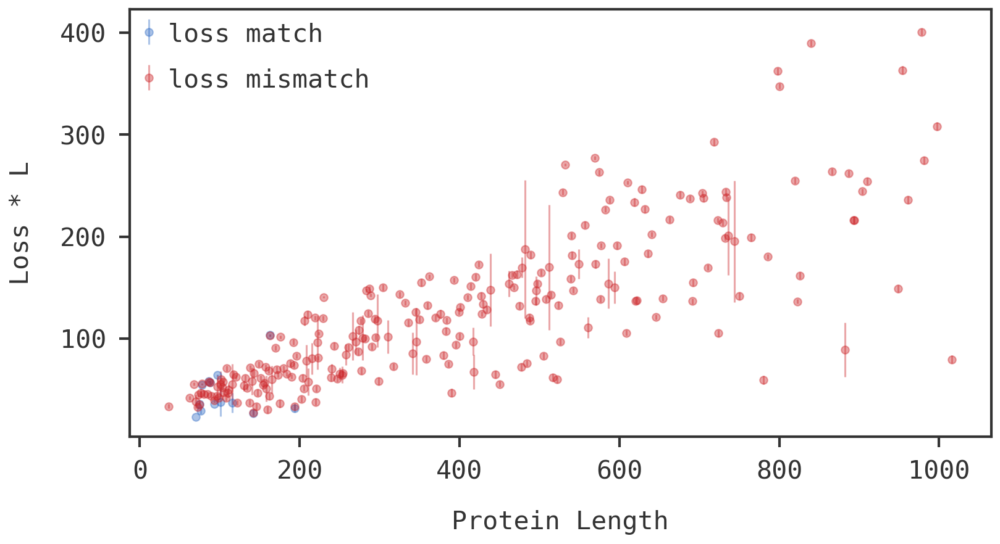

In [34]:
avg_loss_matches = list()
std_loss_matches  = list()
lengths_match = sorted(list(loss_match_dict.keys()))
for L in lengths_match:
    avg_loss_matches.append(np.mean([i*L for i in loss_match_dict[L]]))
    std_loss_matches.append(np.std([i*L for i in loss_match_dict[L]]))

avg_loss_mismatches = list()
std_loss_mismatches  = list()
lengths_mismatch = sorted(list(loss_mismatch_dict.keys()))
for L in lengths_mismatch:
    avg_loss_mismatches.append(np.mean([i*L for i in loss_mismatch_dict[L]]))
    std_loss_mismatches.append(np.std([i*L for i in loss_mismatch_dict[L]]))

fig = plt.figure(figsize=(12,6), dpi=150)
ax1 = fig.add_subplot(111)
#ax2 = fig.add_subplot(122)
#ax1.scatter(lengths_match, avg_loss_matches, alpha=0.4, label="loss match")
#ax1.scatter(lengths_mismatch, avg_loss_mismatches, alpha=0.4, label="loss mismatch")
ax1.errorbar(lengths_match, avg_loss_matches, yerr=std_loss_matches, alpha=0.4, label="loss match", marker='o', ls="")
ax1.errorbar(lengths_mismatch, avg_loss_mismatches, yerr=std_loss_mismatches, alpha=0.4, label="loss mismatch", marker='o', ls="")
ax1.set_xlabel("Protein Length")
ax1.set_ylabel("Loss * L")
plt.legend()
plt.show()

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


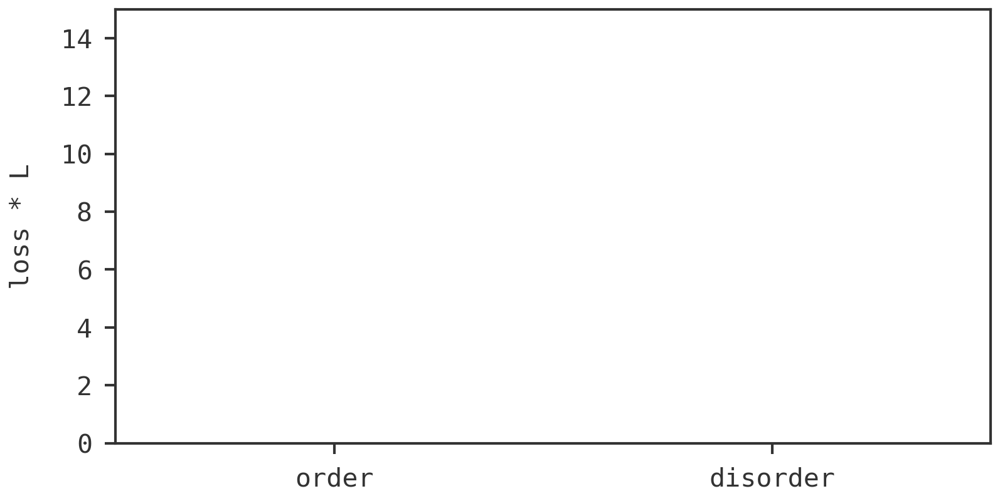

In [35]:
fig = plt.figure(figsize=(12,6), dpi=150)
ax1 = fig.add_subplot(111)
#ax2 = fig.add_subplot(122)
ax1.boxplot([loss_mismatch_in_order, loss_mismatch_in_disorder], labels=["order", "disorder"])
#ax1.scatter(lengths_mismatch, avg_loss_mismatches, alpha=0.4, label="loss mismatch")
ax1.set_ylabel("loss * L")
ax1.set_ylim(0,15)
plt.legend()
plt.show()

In [36]:
avg_loss_mismatches = list()
lengths_mismatch = sorted(list(loss_mismatch_dict.keys()))
for L in lengths_mismatch:
    avg_loss_mismatches.append(np.mean([i*L for i in loss_mismatch_dict[L]]))

In [40]:
##############################
#### De aca para abajo es codigo viejo, quizas reciclable
###############################
### TODO:
### - Loss values between order and disordered regions (scaled by prot length)?
### - 

In [41]:
## perplexity (simple)

disprot_perplex = np.exp(disprot_allloss/disprot_lengths)
mono_perplex = np.exp(mono_allloss/mono_lengths)

NameError: name 'disprot_allloss' is not defined

In [ ]:
## find loss per aa type in disprot
from collections import defaultdict

aa_dict = defaultdict(list)
for protid in disprot_loss.keys():
    print(protid)
    seq = disprot_dict[protid]['seq']
    data = np.array(disprot_loss[protid]['aa1_loss'])
    for i in range(len(data)):
        aa_dict[seq[i]].append(data[i])

hydrophobic_aro = ["W", "Y", "F"]
hydrophobic_ali = ["I", "L", "M", "V", "A"]
positive = ["K", "R", "H"]
negative = ["D", "E"]
polar_neu = ["Q", "N", "X", "S", "T"]
special = ["G", "P", "C"]

classes = [hydrophobic_aro, hydrophobic_ali, positive, negative, polar_neu, special]

fig = plt.figure(figsize=(7,20), dpi=100)
AXs = fig.subplots(len(classes),1,sharex=True)
for i,c in enumerate(classes):
    for AA in c:
#     for AA in aa_dict.keys():
        data = np.array(aa_dict[AA])
        sns.kdeplot(data, label=f"{AA}", ax=AXs[i])
    AXs[i].legend(ncol=2)
plt.show()

In [ ]:
## find loss per aa type in disprot and discriminate between ordered and disordered regions
from collections import defaultdict
from matplotlib.pyplot import cm

aa_dict = defaultdict(list)
aa_dict_disordered = defaultdict(list)
for protid in disprot_loss.keys():
    seq = disprot_dict[protid]['seq']
    disorder = disprot_dict[protid]['disorder']
    data = np.array(disprot_loss[protid]['aa1_loss'])
    for i in range(len(data)):
        if disorder[i] == "-":
            aa_dict[seq[i]].append(data[i]*len(seq))   ### Should we multiply by seq len?? true difference lies there
        else:
            aa_dict_disordered[seq[i]].append(data[i]*len(seq))

allAAs = list(aa_dict.keys())            
NUM_COLORS = len(allAAs)
color = cm.rainbow(np.linspace(0, 1, NUM_COLORS))
AA2num = dict(zip(allAAs, np.arange(NUM_COLORS)))

hydrophobic_aro = ["W", "Y", "F"]
hydrophobic_ali = ["I", "L", "M", "V", "A"]
positive = ["K", "R", "H"]
negative = ["D", "E"]
polar_neu = ["Q", "N", "S", "T"]
special = ["G", "P", "C"]

classes = [hydrophobic_aro, hydrophobic_ali, positive, negative, polar_neu, special]

fig = plt.figure(figsize=(7,22), dpi=200)
AXs = fig.subplots(len(classes),1,sharex=True)
for i,c in enumerate(classes):
    for AA in c:
#     for AA in aa_dict.keys():
        data = np.array(aa_dict[AA])
        data_diso = np.array(aa_dict_disordered[AA])
        sns.kdeplot(data, label=f"{AA} ord", ax=AXs[i], color = color[AA2num[AA]])
        sns.kdeplot(data_diso, label=f"{AA} disord", ax=AXs[i], color = color[AA2num[AA]], linestyle="--")
    AXs[i].legend(ncol=2)
plt.show()

In [ ]:
# Single protein sequential loss for 1aa and 5aa. Disordered regions are in red
#protid = alldisprot_prots[1]
alldisprot_prots = list(disprot_loss.keys())

for protid in alldisprot_prots:
    seq = disprot_dict[protid]['seq']
    disorder = disprot_dict[protid]['disorder']
    data = np.array(disprot_loss[protid]['aa1_loss'])
    colorlist = list()
    for i in range(len(data)):
        if disorder[i] == "-":
            colorlist.append("b")
        else:
            colorlist.append("r")

    fig = plt.figure()
    ax  = fig.add_subplot(111)
    ax.scatter(np.arange(len(data)), data, color=colorlist)
    ax.set_title(f"{protid}-{len(seq)}")
    plt.show()

# data = np.array(disprot_loss[protid]['aa5_loss'])
# colorlist = list()
# for i in range(len(data)):
#     if disorder[i] == "-":
#         colorlist.append("b")
#     else:
#         colorlist.append("r")

# fig = plt.figure()
# ax  = fig.add_subplot(111)
# ax.scatter(np.arange(len(data)), data, color=colorlist)
# plt.show()